<a href="https://colab.research.google.com/github/davies-w/BeatNet/blob/main/mcfee_b2r_advanced.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[bit.ly/mcfee_b2r](https://bit.ly/mcfee_b2r) \

was [bit.ly/LaplaceB2R](https://bit.ly/LaplaceB2R)

TODO(wdavies):

- [ ] Gaussian EM clustering
- [ ] DBSCAN clustering
- [ ] BeatNet Beats
- [ ] Remove Vocals

This notebook implements the laplacian segmentation method of McFee and Ellis, 2014, with a couple of minor stability improvements.
From: https://librosa.org/doc/latest/auto_examples/plot_segmentation.html

\# Code source: Brian McFee

\# License: ISC

In [1]:
!pip install -q pydub > /dev/null
!pip install --upgrade --no-deps --force-reinstall --quiet git+https://github.com/davies-w/pyavanimate.git  > /dev/null
!pip install -q hdbscan > /dev/null
import numpy as np
import scipy
import matplotlib.pyplot as plt
import scipy
import sklearn.cluster
import librosa
import hdbscan

In [2]:
#@title Load files from GDrive Storage
from google.colab import drive

# Files stored on gdrive.
drive.mount('/content/gdrive', readonly=True)

# change this line if you have a different song loaded into your GDrive.
!cp gdrive/MyDrive/born.mp3 .

Mounted at /content/gdrive


In [3]:
#@title helper functions

import sys, traceback
from os import path
from pydub import AudioSegment
from scipy.io import wavfile
import IPython
from matplotlib import pyplot as plt
import numpy as np
import seaborn as sns
import pyavanimate

from IPython.display import display, Markdown, HTML, Javascript, Audio



def audiosegment_to_np_norm(audiosegment):
    """
    Converts pydub audio segment into np.float32 of shape [duration_in_seconds*sample_rate, channels],
    where each value is in range [-1.0, 1.0].
    Returns tuple (audio_np_array, sample_rate).
    """
    return np.array(audiosegment.get_array_of_samples(), dtype=np.float32).reshape((-1, audiosegment.channels)) / (
            1 << (8 * audiosegment.sample_width - 1)), audiosegment.frame_rate

def audiosegment_to_wav(audiosegment):
    return audiosegment_to_np_norm(audiosegment)

def audiosegement_to_np(audiosegment):
    """
    Returns tuple (audio_np_array, sample_rate).
    """
    return np.array(audiosegment.get_array_of_samples()).reshape((-1, audiosegment.channels)), audiosegment.frame_rate

# this assumes that its int16 going in.
def int_np_to_audiosegment(nparr, framerate):
    if nparr.dtype.itemsize not in (1, 2, 4):
      raise ValueError("Numpy Array must contain 8, 16, or 32 bit values.")
    monos = []
    for i in range(2):
        m = nparr[:, i]
        dubseg = AudioSegment(m.tobytes(), frame_rate=framerate, sample_width=nparr.dtype.itemsize, channels=1)
        monos.append(dubseg)
    audiosegment = AudioSegment.from_mono_audiosegments(monos[0], monos[1])
    return audiosegment

def wav_to_audiosegment(filename):
  # read mp3 and convert to norm_waveform, norm_sample_rate
  audiosegment = AudioSegment.from_wav(filename)
  print("song length (seconds): {dur}".format(dur=audiosegment.duration_seconds))
  print("sample width (bytes): {sw}".format(sw=audiosegment.sample_width))
  print("num channels: {ch}".format(ch=audiosegment.channels))
  print("frame sample rate: {fr}".format(fr=audiosegment.frame_rate))
  print("frame count: {fc}".format(fc=int(audiosegment.frame_count())))
  return audiosegment

def mp3_to_audiosegment(filename):
  # read mp3 and convert to norm_waveform, norm_sample_rate
  audiosegment = AudioSegment.from_mp3(filename)
  print("song length (seconds): {dur}".format(dur=audiosegment.duration_seconds))
  print("sample width (bytes): {sw}".format(sw=audiosegment.sample_width))
  print("num channels: {ch}".format(ch=audiosegment.channels))
  print("frame sample rate: {fr}".format(fr=audiosegment.frame_rate))
  print("frame count: {fc}".format(fc=int(audiosegment.frame_count())))
  return audiosegment

def audiosegment_change_sample_rate(audiosegment, new_sample_rate):
    return audiosegment.set_frame_rate(new_sample_rate)

def display_sample(waveform, sample_rate, start, end):
  #display it
  sample_stereo = waveform[start*sample_rate:end*sample_rate:]
  sample_left = sample_stereo[:, 0]
  sample_left_short = sample_left[0:100]
  IPython.display.display(IPython.display.Audio(sample_left, rate=sample_rate))
  plt.plot(sample_left_short)


import scipy.io
import io

def float_np_to_audiosegment(wav_data, wav_sr):
  wav_io = io.BytesIO()
  scipy.io.wavfile.write(wav_io, wav_sr, wav_data)
  wav_io.seek(0)
  return AudioSegment.from_wav(wav_io)


In [4]:
#@title load Born To Run MP3
born_audiosegment = mp3_to_audiosegment("born.mp3")
#born_audiosegment= born_audiosegment[200:]
born_wav, born_sr = audiosegment_to_wav(born_audiosegment)
born_tracks = [born_wav]
born_duration = (born_wav.shape[0]/born_sr)
print(f"post trim duration: {int(born_duration*1000)}")

song length (seconds): 270.21167800453514
sample width (bytes): 2
num channels: 2
frame sample rate: 44100
frame count: 11916335
post trim duration: 270211


In [5]:
#Set Up Data:
y=born_wav[:,0]
sr=born_sr

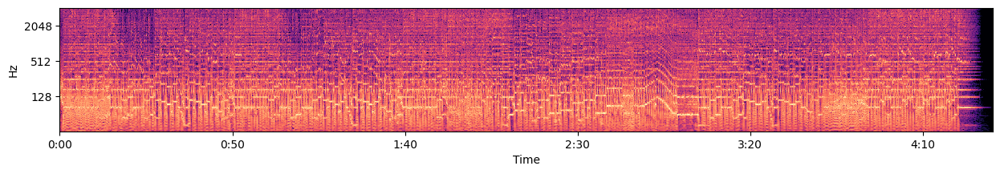

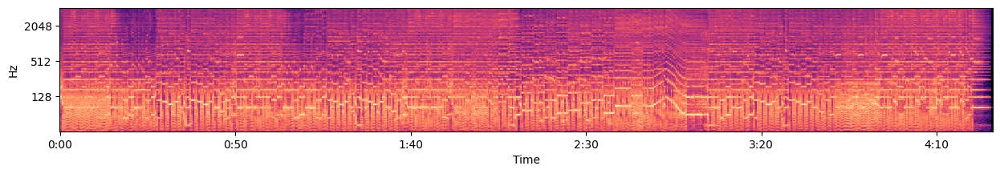

In [6]:
################################################################################
#
# Compute and plot a log-power CQT
#
################################################################################

BINS_PER_OCTAVE = 12 * 3
N_OCTAVES = 7
C = librosa.amplitude_to_db(np.abs(librosa.cqt(y=y, sr=sr,
                                        bins_per_octave=BINS_PER_OCTAVE,
                                        n_bins=N_OCTAVES * BINS_PER_OCTAVE)),
                            ref=np.max)


fig, ax = plt.subplots(1,1, figsize=(15,2))
librosa.display.specshow(C, y_axis='cqt_hz', sr=sr,
                         bins_per_octave=BINS_PER_OCTAVE,
                         x_axis='time', ax=ax)
plt.show()
###############################################################################
#
# To reduce dimensionality, we'll beat-synchronous the CQT
#
###############################################################################
tempo, beats = librosa.beat.beat_track(y=y, sr=sr, trim=False)
Csync = librosa.util.sync(C, beats, aggregate=np.median)

# For plotting purposes, we'll need the timing of the beats
# we fix_frames to include non-beat frames 0 and C.shape[1] (final frame)
beat_times = librosa.frames_to_time(librosa.util.fix_frames(beats, x_min=0),
                                    sr=sr)

fig, ax = plt.subplots(1,1, figsize=(15,2))
librosa.display.specshow(Csync, bins_per_octave= BINS_PER_OCTAVE,
                         y_axis='cqt_hz', x_axis='time',
                         x_coords=beat_times, ax=ax)
plt.show()

Let's build a weighted recurrence matrix using beat-synchronous CQT
(Equation 1)
width=3 prevents links within the same bar
mode='affinity' here implements S_rep (after Eq. 8)



In [7]:
R = librosa.segment.recurrence_matrix(Csync, width=3, mode='affinity',
                                      sym=True)

# Enhance diagonals with a median filter (Equation 2)
df = librosa.segment.timelag_filter(scipy.ndimage.median_filter)
Rf = df(R, size=(1, 7))

Now let's build the sequence matrix (S_loc) using mfcc-similarity

  $R_\text{path}[i, i\pm 1] = \exp(-\|C_i - C_{i\pm 1}\|^2 / \sigma^2)$

Here, we take $\sigma$ to be the median distance between successive beats.




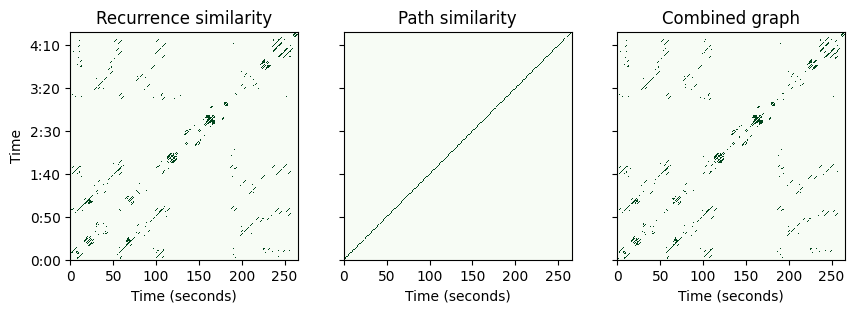

In [8]:
mfcc = librosa.feature.mfcc(y=y, sr=sr)
Msync = librosa.util.sync(mfcc, beats)

path_distance = np.sum(np.diff(Msync, axis=1)**2, axis=0)
sigma = np.median(path_distance)
path_sim = np.exp(-path_distance / sigma)

R_path = np.diag(path_sim, k=1) + np.diag(path_sim, k=-1)

################################################################################
#
# And compute the balanced combination (Equations 6, 7, 9)
#
################################################################################
deg_path = np.sum(R_path, axis=1)
deg_rec = np.sum(Rf, axis=1)

mu = deg_path.dot(deg_path + deg_rec) / np.sum((deg_path + deg_rec)**2)

A = mu * Rf + (1 - mu) * R_path

###############################################################################
#
# Plot the resulting graphs (Figure 1, left and center)
#
###############################################################################
fig, ax = plt.subplots(ncols=3, sharex=True, sharey=True, figsize=(10, 4))

Rf_matrix = np.array(Rf)
Rf_matrix[Rf_matrix<0.007] = 0.0
Rf_matrix[Rf_matrix>=0.007] = 1.0
librosa.display.specshow(Rf_matrix, cmap='Greens', y_axis='time', x_axis='s',
                         y_coords=beat_times, x_coords=beat_times, ax=ax[0])
ax[0].set(title='Recurrence similarity')
ax[0].label_outer()

R_path_matrix = np.array(R_path)
R_path_matrix[R_path_matrix<0.0029] = 0.0
R_path_matrix[R_path_matrix>=0.0029] = 1.0
librosa.display.specshow(R_path_matrix, cmap='Greens', y_axis='time', x_axis='s',
                         y_coords=beat_times, x_coords=beat_times, ax=ax[1])
ax[1].set(title='Path similarity')
ax[1].label_outer()

A_matrix = np.array(A)
A_matrix[A_matrix<0.002] = 0.0
A_matrix[A_matrix>=0.002] = 1.0
librosa.display.specshow(A_matrix, cmap='Greens', y_axis='time', x_axis='s',
                         y_coords=beat_times, x_coords=beat_times, ax=ax[2])
ax[2].set(title='Combined graph')
ax[2].label_outer()

<IPython.core.display.Javascript object>

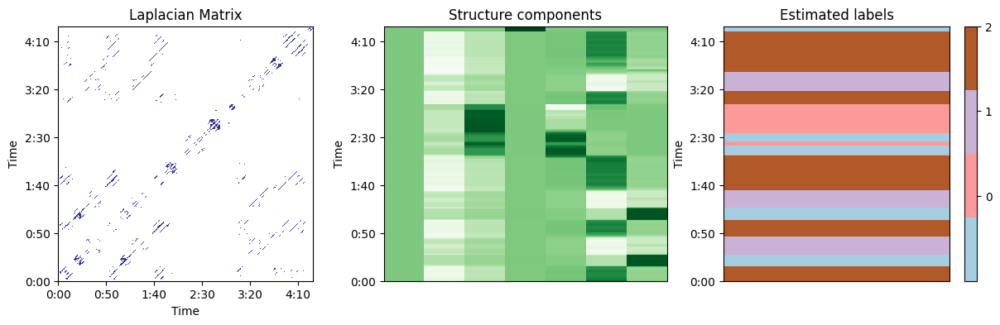

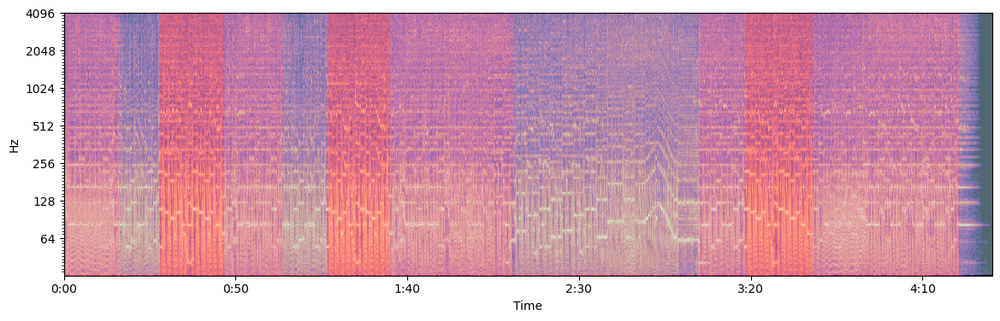

In [14]:
# @title Section Finding Logic
dimensions = 7 # @param {type:"integer"}
clusters = 2 # @param {type:"integer"}

################################################################################
#
# Let's compute the normalized Laplacian (Eq. 10)
# https://en.wikipedia.org/wiki/Laplacian_matrix
#
################################################################################
L = scipy.sparse.csgraph.laplacian(A, normed=True)


# and its spectral decomposition
evals, evecs = scipy.linalg.eigh(L)


# We can clean this up further with a median filter.
# This can help smooth over small discontinuities
evecs = scipy.ndimage.median_filter(evecs, size=(9, 1))


# cumulative normalization is needed for symmetric normalize laplacian eigenvectors
Cnorm = np.cumsum(evecs**2, axis=1)**0.5

# If we want k clusters, use the first k normalized eigenvectors.
# Fun exercise: see how the segmentation changes as you vary k

k = dimensions
X = evecs[:, :k] / Cnorm[:, k-1:k]

################################################################################
#
# Let's use these k components to cluster beats into segments (Algorithm 1)
#
################################################################################
num_clusters=clusters
KM = sklearn.cluster.KMeans(n_clusters=num_clusters, n_init=100)
seg_ids = KM.fit_predict(X)

clusterer = hdbscan.HDBSCAN(min_cluster_size=64)
cluster_labels = clusterer.fit_predict(X)
seg_ids = cluster_labels
num_clusters= 1 + max(cluster_labels) - min(cluster_labels)
################################################################################
#
# and plot the results
#
################################################################################
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))

fig, ax = plt.subplots(ncols=3, figsize=(15, 4))
colors = plt.get_cmap('Paired', num_clusters)

L_matrix=np.array(L)
L_matrix[L_matrix<0.0] = -1.0
L_matrix[L_matrix>=0.0] = 1.0
librosa.display.specshow(L_matrix, cmap='terrain', y_axis='time', x_axis='time',
                         y_coords=beat_times, x_coords=beat_times, ax=ax[0])
ax[0].set(title='Laplacian Matrix')
ax[0].label_outer()

librosa.display.specshow(X,
                         cmap="Greens",
                         y_axis='time',
                         y_coords=beat_times, ax=ax[1])
ax[1].set(title='Structure components')


img = librosa.display.specshow(np.atleast_2d(seg_ids).T, cmap=colors,
                         y_axis='time',
                         x_coords=[0, 1], y_coords=list(beat_times) + [beat_times[-1]],
                         ax=ax[2])
ax[2].set(title='Estimated labels')
fig.colorbar(img, ax=[ax[2]], ticks=range(k))

################################################################################
#
# Locate segment boundaries from the label sequence
#
################################################################################

bound_beats = 1 + np.flatnonzero(seg_ids[:-1] != seg_ids[1:])

# Count beat 0 as a boundary
bound_beats = librosa.util.fix_frames(bound_beats, x_min=0)

# Compute the segment label for each boundary
bound_segs = list(seg_ids[bound_beats])

# Convert beat indices to frames
bound_frames = beats[bound_beats]

# Make sure we cover to the end of the track
bound_frames = librosa.util.fix_frames(bound_frames,
                                       x_min=None,
                                       x_max=C.shape[1]-1)

################################################################################
#
# And plot the final segmentation over original CQT
#
#
################################################################################
# sphinx_gallery_thumbnail_number = 5

import matplotlib.patches as patches
bound_times = librosa.frames_to_time(bound_frames, sr=sr)
freqs = librosa.cqt_frequencies(n_bins=C.shape[0],
                                fmin=librosa.note_to_hz('C1'),
                                bins_per_octave=BINS_PER_OCTAVE)

fig, ax = plt.subplots(1,1,  figsize=(14, 4))
librosa.display.specshow(C, y_axis='cqt_hz', sr=sr,
                         bins_per_octave=BINS_PER_OCTAVE,
                         x_axis='time', ax=ax)

for interval, label in zip(zip(bound_times, bound_times[1:]), bound_segs):
    ax.add_patch(patches.Rectangle((interval[0], freqs[0]),
                                   interval[1] - interval[0],
                                   freqs[-1],
                                   facecolor=colors(label),
                                   alpha=0.50))
plt.show()

In [10]:
print(X.shape)
print(num_clusters)
print(seg_ids)


(653, 15)
3
[-1 -1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1 -1 -1  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1 -1 -1 -1  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

In [11]:
from sklearn.manifold import TSNE
import plotly.express as px

tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X)

prev, n = -1, -1
op = []
for i in seg_ids:
  if prev != i:
    n += 1
    prev = i
  op.append(n)

fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1],  color=op)
fig.update_traces(marker={'size': 5})
fig.update_layout(
    title="t-SNE visualization of born2run",
    xaxis_title="First t-SNE",
    yaxis_title="Second t-SNE",
)
fig.show()

In [13]:
#@title Animate - Sections, Names, and Lyrics
import datetime
import pyavanimate
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))


for i, (interval, label) in enumerate(zip(zip(bound_times, bound_times[1:]), bound_segs)):
    display(Markdown(f"##{i} Section:{label} :  {datetime.timedelta(seconds=int(interval[0]))}  [{int(interval[1]-interval[0])}]"))
    pyavanimate.animate_music(resolution=0.25, clip_length=5, seek=interval[0], stereo_song_amp_aac=born_tracks, song_rate=born_sr,
                              height_scale=0.75, autoplay=0, colors=["lawngreen", "mediumseagreen"],
                              markers = [{"librosa_beats": list(map(lambda x: {'start': x}, beat_times))}, ["librosa_beats"]] )

<IPython.core.display.Javascript object>

##0 Section:-1 :  0:00:00  [1]

##1 Section:1 :  0:00:01  [14]

##2 Section:-1 :  0:00:15  [12]

##3 Section:0 :  0:00:28  [8]

##4 Section:-1 :  0:00:36  [1]

##5 Section:0 :  0:00:38  [6]

##6 Section:1 :  0:00:45  [19]

##7 Section:-1 :  0:01:04  [12]

##8 Section:0 :  0:01:16  [9]

##9 Section:-1 :  0:01:25  [2]

##10 Section:0 :  0:01:27  [6]

##11 Section:1 :  0:01:34  [29]

##12 Section:-1 :  0:02:03  [61]

##13 Section:1 :  0:03:05  [13]

##14 Section:0 :  0:03:18  [7]

##15 Section:1 :  0:03:26  [0]

##16 Section:-1 :  0:03:27  [1]

##17 Section:0 :  0:03:28  [7]

##18 Section:1 :  0:03:36  [44]

##19 Section:-1 :  0:04:20  [9]

In [12]:
#@title Animate - Sections, Names, and Lyrics
import datetime
import pyavanimate
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'''))


from collections import Counter
most_frequent_section = Counter(bound_segs).most_common()[0][0]
most_frequent_section_counter = Counter(bound_segs).most_common()[0][1]
#
# MAKE IT FADE OUT LENGTH, SHORTEST MOST FREQUENT SEGMENT
#

shortest_most_frequent_segment = (born_wav.shape[0]/born_sr)

for i, (interval, label) in enumerate(zip(zip(bound_times, bound_times[1:]), bound_segs)):
  if label == most_frequent_section:
    most_frequent_section_counter -= 1
    if interval[1]-interval[0] < shortest_most_frequent_segment :
      shortest_most_frequent_segment  = interval[1]-interval[0]
    if most_frequent_section_counter == 0:

      end_edit = born_audiosegment[(interval[0]-5)*1000:(interval[0]+shortest_most_frequent_segment)*1000]
      end_edit = end_edit.fade(to_gain=-120.0, start=5000, duration = int(shortest_most_frequent_segment*1000))
      end_edit_wav, end_edit_sr = audiosegment_to_wav(end_edit )
      end_edit_tracks = [end_edit_wav]

      pyavanimate.animate_music(resolution=1, clip_length=end_edit.duration_seconds, seek=0, stereo_song_amp_aac=end_edit_tracks, song_rate=end_edit_sr,
                              height_scale=0.75, autoplay=0, colors=["lawngreen", "mediumseagreen"],
                              markers = [{"librosa_beats": list(map(lambda x: {'start': x}, beat_times))}, ["librosa_beats"]] )

    #display(Markdown(f"##{i} Section:{label} :  {datetime.timedelta(seconds=int(interval[0]))}  [{int(interval[1]-interval[0])}]"))
    #pyavanimate.animate_music(resolution=0.25, clip_length=5, seek=interval[0], stereo_song_amp_aac=born_tracks, song_rate=born_sr,
    #                          height_scale=0.75, autoplay=0, colors=["lawngreen", "mediumseagreen"],
    #                          markers = [{"librosa_beats": list(map(lambda x: {'start': x}, beat_times))}, ["librosa_beats"]] )
    #pyavanimate.animate_music(resolution=0.25, clip_length=5, seek=interval[1]-5, stereo_song_amp_aac=born_tracks, song_rate=born_sr,
    #                          height_scale=0.75, autoplay=0, colors=["lawngreen", "mediumseagreen"],
    #                          markers = [{"librosa_beats": list(map(lambda x: {'start': x}, beat_times))}, ["librosa_beats"]] )


<IPython.core.display.Javascript object>